# **Music Generation**
#  

## **Introduction**
### Modern machine learning techniques have a wide range of applications in the field of music analysis and generation. This project explores the processing of MIDI files, analyzing musical sequences and applying recurrent neural networks (LSTM) to predict and generate musical fragments. The main steps include data loading and preprocessing, chord and note distribution analysis, training dataset creation, sequence normalization and vectorization. During training, the model learns patterns in the chord sequences, which allows it to predict subsequent notes and generate new musical compositions. Data selection techniques, rare chord filtering, and optimization of the model's hyperparameters are used to improve the quality of the predictions. The final result of the project is a trained neural network model capable of generating harmonic sequences based on the studied musical patterns.
### The data I use are midi files of **classical music** from Kaggle. This model can be used for any midi format music, and it is easier to handle modern music because it is more homogeneous.
### **LSTM** is a type of recurrent neural network (RNN) designed for processing and predicting sequential data, such as text, audio, time series, or music. Unlike standard RNNs, which suffer from the vanishing gradient problem, LSTMs can remember important information over long time intervals, making them particularly useful for tasks with long-term dependencies.

##  **Install libraries**
####    

In [1]:
!sudo apt-get install fluidsynth -y > /dev/null 2>&1
!pip install midi2audio > /dev/null 2>&1

In [2]:
import os
import tqdm
import random
import multiprocessing
import collections
import pickle

import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

from collections import Counter

from music21 import stream, converter, instrument, note, chord

from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, LSTM, Dense, Dropout, concatenate
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import LambdaCallback

from midi2audio import FluidSynth

from IPython.display import Audio

import warnings
warnings.simplefilter("ignore")

### This script sets up the environment for processing MIDI data and training an LSTM-based neural network for music generation. It imports essential libraries for file handling (os, tqdm, random, multiprocessing, pickle), numerical computation (numpy, pandas), and data visualization (seaborn, matplotlib). The music21 module is used to parse and process MIDI files, extracting notes, chords, and instrument information. A deep learning model is built using TensorFlow/Keras, with an LSTM architecture to handle sequential data, along with layers like Dense and Dropout to refine learning. The Adam optimizer and custom callbacks (LambdaCallback) assist in training. Finally, FluidSynth is used to convert generated MIDI sequences into audio, while warnings are suppressed to keep the output clean. The overall goal is to create a system that learns musical patterns from MIDI files and generates new compositions.

##  **Define constants**
###  

In [3]:
BATCH_SIZE = 32
NUM_EPOCHS = 90
SEQUENCE_LENGTH = 64

### **These parameters control the training process of the model:** BATCH_SIZE = 32 specifies that the model will process 32 samples at a time before updating the weights, providing a balance between computational efficiency and generalization. NUM_EPOCHS = 90 means the model will iterate over the entire dataset 90 times, allowing for better learning but potentially leading to overfitting if too many epochs are used. SEQUENCE_LENGTH = 64 defines the number of time steps (or notes) the model will consider at once, providing 64 notes as context for sequence prediction, which influences the model's ability to capture patterns while affecting computational complexity.

In [4]:
root = "/kaggle/input/classical-music-midi/"

### This line defines the variable root, which stores the path to the dataset directory containing MIDI files. 
##  

## **Collect MIDI file paths**

In [5]:
file_paths = []
labels = [] 

for folder in tqdm.tqdm(os.listdir(root)):  
    folder_path = os.path.join(root, folder)  
    if not os.path.isdir(folder_path):
        continue

    for file in os.listdir(folder_path):  
        if file.endswith(".mid"):  
            file_paths.append(os.path.join(folder_path, file))  
            labels.append(folder)  

100%|██████████| 19/19 [00:00<00:00, 152.74it/s]


### This code iterates through the dataset directory (root) and collects MIDI file paths along with their corresponding labels (folder names).
###  

In [6]:
data = pd.DataFrame({
    "midi": file_paths,
    "label": labels
})

### This code creates a Pandas DataFrame named data, which organizes the collected MIDI file paths and their corresponding labels into a structured tabular format.
###  

In [7]:
data.head()

,midi,label
0,/kaggle/input/classical-music-midi/brahms/br_i...,brahms
1,/kaggle/input/classical-music-midi/brahms/br_i...,brahms
2,/kaggle/input/classical-music-midi/brahms/brah...,brahms
3,/kaggle/input/classical-music-midi/brahms/brah...,brahms
4,/kaggle/input/classical-music-midi/brahms/brah...,brahms


### This structure allows easy access to both the MIDI files and their corresponding labels for further processing or model training.
###  

## **EDA and Data preporation**
##   

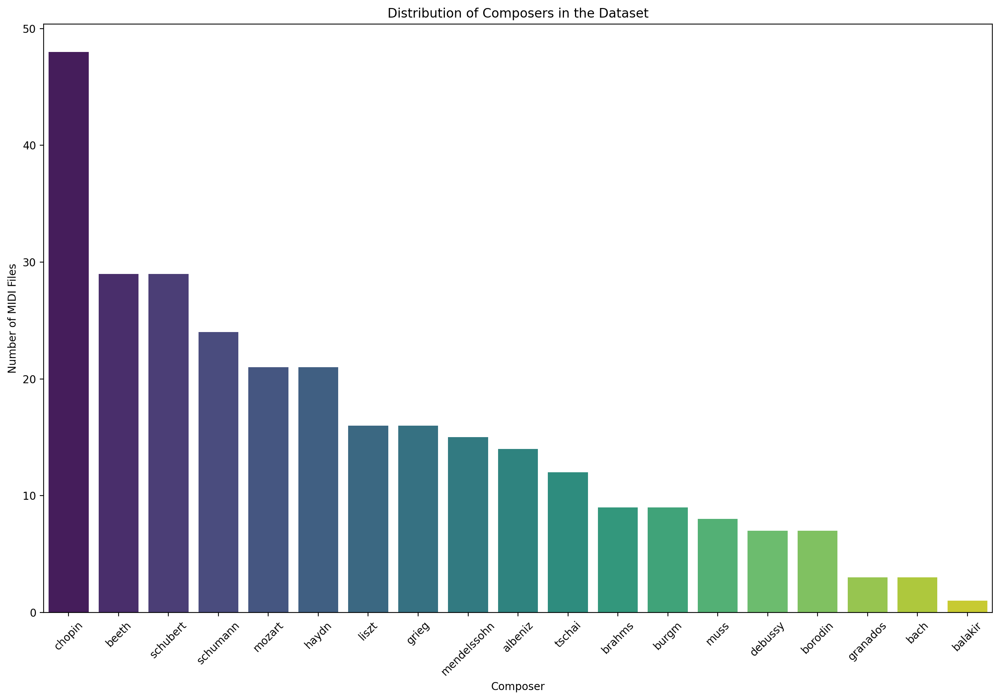

In [8]:
sorted_labels = data["label"].value_counts().index  

plt.figure(figsize=(16, 10))
sns.countplot(x=data["label"], order=sorted_labels, palette="viridis") 

plt.title("Distribution of Composers in the Dataset")
plt.xlabel("Composer")
plt.ylabel("Number of MIDI Files")
plt.xticks(rotation=45)
plt.show()

### This code creates a count plot to visualize the distribution of composers (or labels) in your dataset using Seaborn and Matplotlib
###   


### **Round the chord duration to fixed values.**
### This function, round_chord_durations, is used to round the duration of a chord to fixed values based on predefined thresholds. The goal is to simplify or standardize chord durations for easier processing or analysis.

In [9]:
def round_chord_durations(duration):
    if duration > 1.5:  
        return 4
    elif duration > 1.0:  
        return 2
    elif duration > 0.5:  
        return 1
    elif duration > 0.25:  
        return 0.5
    elif duration > 0.125:  
        return 0.25
    else:  
        return 0.125

### **Processes a MIDI file and extracts chords:**

In [10]:
def process_midi(file):
    try:
        midi = converter.parse(file).chordify()  # Только аккорды
        elements = midi.flat.notes

        processed_chords = []
        for el in elements:
            if isinstance(el, chord.Chord):  
                chord_name = ".".join(n.nameWithOctave for n in el.pitches)
                duration = round_chord_durations(el.duration.quarterLength)
                processed_chords.append((chord_name, duration))

        return processed_chords

    except Exception as e:
        print(f"Error: {file}: {e}")
        return []

### Process files in parallel to increase processing speed:

In [11]:
def extract_chords_from_midi_parallel(midi_files, num_workers=None):
    num_workers = num_workers or os.cpu_count()
    with multiprocessing.Pool(num_workers) as pool:
        results = pool.map(process_midi, midi_files)
    return [chord for file_chords in results for chord in file_chords]

In [12]:
processed_chords = extract_chords_from_midi_parallel(data["midi"].tolist())


In [13]:
print("Total chords: ", len(processed_chords))
print("First 20 processed:", processed_chords[:20])

Total chords:  361753
First 20 processed: [('A1.A4.C5', 0.5), ('A2.A4.C5', 0.25), ('A2.A4.C5', 0.25), ('E3.A4.C5', 0.5), ('A2.D3.F4.A4.D5', 4), ('A1.A4.C5', 0.5), ('A2.A4.C5', 0.25), ('A2.A4.C5', 0.25), ('E3.A4.C5', 0.5), ('A2.F3.D4.G#4.B4', 4), ('A1.F#4.A4', 0.5), ('A2.F#4.A4', 0.25), ('A2.F#4.A4', 0.25), ('C3.F#4.A4', 0.5), ('A2.E-3.C4.C5', 1), ('A2.E-3.F#4.A4', 1), ('E2.E4.G#4', 0.5), ('B2.E4.G#4', 0.5), ('E3.E4.G#4', 0.5), ('E2.E3.B3.G#4.B4', 4)]


####  
### **Simplify the chords**, leaving only one note of each type. To speed up processing.

In [14]:
def simplify_chords(data):
    simplified_chords = []
    for chord_name, chord_duration in data:
        cleaned_chord = ""

        #Removing hyphens
        chord_name = chord_name.replace("-", "")
        # sort chords
        split_chord = sorted(chord_name.split("."), reverse=True)

        for split in split_chord:
            
            processed_note = split[0] 

            if processed_note not in cleaned_chord: 
                processed_note += "2" if split[-1] in "12" else split[-1]
                cleaned_chord += processed_note + "."

        if cleaned_chord.endswith("."):
            cleaned_chord = cleaned_chord[:-1]

        simplified_chords.append((cleaned_chord, chord_duration))

    return simplified_chords

In [15]:
simplified_nots = simplify_chords(processed_chords)

print("Total chords after processing:", len(simplified_nots))
print("Первые 20 упрощённых аккордов:", simplified_nots[:20])


Total chords after processing: 361753
Первые 20 упрощённых аккордов: [('C5.A4', 0.5), ('C5.A4', 0.25), ('C5.A4', 0.25), ('E3.C5.A4', 0.5), ('F4.D5.A4', 4), ('C5.A4', 0.5), ('C5.A4', 0.25), ('C5.A4', 0.25), ('E3.C5.A4', 0.5), ('G4.F3.D4.B4.A2', 4), ('F4.A4', 0.5), ('F4.A4', 0.25), ('F4.A4', 0.25), ('F4.C3.A4', 0.5), ('E3.C5.A2', 1), ('F4.E3.A4', 1), ('G4.E4', 0.5), ('G4.E4.B2', 0.5), ('G4.E4', 0.5), ('G4.E3.B4', 4)]


### The function simplify_chords simplifies a list of chords by removing redundant information and standardizing the format. It takes a list of chord names and durations as input and processes each chord by removing hyphens, sorting the notes in reverse order, and ensuring each note is unique within the chord. This function is useful for normalizing chord representations, making them easier to handle in tasks like music analysis or machine learning models.
###  

### leave only **frequently occurring chords**

In [16]:
chord_counts = Counter(chord[0] for chord in simplified_nots)

filtered_chords = [chord for chord in simplified_nots if chord_counts[chord[0]] > 150]

print("Filtered chords length: ", len(filtered_chords))

Filtered chords length:  239702


### By removing rare chords I reduced the data size by half

### The code counts the frequency of each chord in the simplified_nots list using the Counter from the collections module, where chord[0] represents the chord name. It then filters out chords that appear fewer than 150 times, keeping only the more frequent chords in the filtered_chords list. Finally, it prints the length of the filtered list, showing how many chords meet the frequency threshold. This process helps to remove rare chords, focusing the analysis or model training on the more common ones.

### Here I translate chords into **numerical format** for ease of processing:

In [17]:
unique_chords = list(set(chord[0] for chord in filtered_chords))

chord_to_int = {chord: i for i, chord in enumerate(unique_chords)}

int_chords = [chord_to_int[chord[0]] for chord in filtered_chords]

### Chord distribution plot

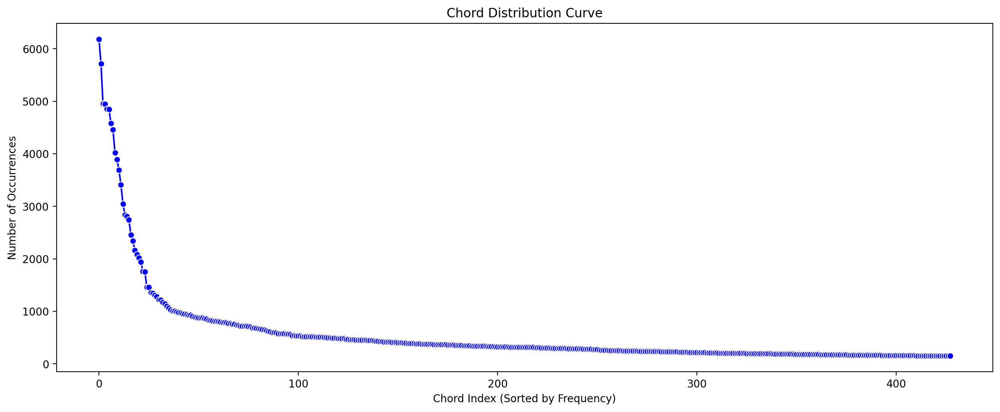

In [18]:
chord_counts = Counter(int_chords)

chord_df = pd.DataFrame(chord_counts.items(), columns=["Chord", "Count"]).sort_values(by="Count", ascending=False)

plt.figure(figsize=(16, 6))
sns.lineplot(x=range(len(chord_df)), y=chord_df["Count"], marker="o", linestyle="-", color="b")

plt.title("Chord Distribution Curve")
plt.xlabel("Chord Index (Sorted by Frequency)")
plt.ylabel("Number of Occurrences")
plt.show()

### The notes are not evenly distributedb some are very many. But it's good that I got rid of the rare chords.

## **Prepare data for training a sequence-based model**

In [19]:
sequence_length = SEQUENCE_LENGTH
X, y = [], []

for i in range(len(int_chords) - sequence_length):
    X.append(int_chords[i:i+sequence_length])
    y.append(int_chords[i+sequence_length])

X = np.array(X)
y = np.array(y)

y = to_categorical(y, num_classes=len(unique_chords))

### This code prepares the data for training by splitting the sequence of chords into input-output pairs (where X is a sequence of sequence_length chords, and y is the next chord to predict). The one-hot encoding ensures that the model can predict the probability distribution over all possible chords. This setup is commonly used for training models that predict the next note or chord in a musical sequence.

## **Model creating**

In [20]:
model = Sequential([
    LSTM(512, input_shape=(sequence_length, 1), return_sequences=True),
    Dropout(0.2),
    LSTM(256),
    Dense(256),
    Dropout(0.2),
    Dense(128, activation='relu'),
    Dense(len(unique_chords), activation='softmax')
])

optimizer = Adam(learning_rate=0.0005)
model.compile(loss="categorical_crossentropy", optimizer=optimizer)
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 64, 512)             │       1,052,672 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 64, 512)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 256)                 │         787,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 428)                 │          55,212 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,994,028 (7.61 MB)

 Trainable params: 1,994,028 (7.61 MB)

 Non-trainable params: 0 (0.00 B)

### This code defines and compiles a sequential LSTM-based neural network for music sequence prediction. The model consists of two LSTM layers: 
### the first with 512 units and return_sequences=True to maintain the sequential nature of the data, followed by a 256-unit LSTM layer. 
### Dropout layers (0.2) are used to reduce overfitting. 
### The network then has two dense layers: one with 256 units, another with 128 units using ReLU activation for non-linearity, and a final dense layer with a softmax activation to predict the next chord among len(unique_chords) possible classes. 
### The model is compiled with the Adam optimizer (learning_rate=0.0005) and categorical cross-entropy loss, making it suitable for multi-class classification.

In [21]:
X = np.expand_dims(X, axis=-1)


### Reshape the X array by adding an extra dimension at the end, making it suitable for input into an LSTM model.

In [22]:
def custom_log(epoch, logs):
    if (epoch + 1) % 5 == 0:
        print(f"Epoch {epoch + 1}/{NUM_EPOCHS} - loss: {logs['loss']:.4f}")

log_callback = LambdaCallback(on_epoch_end=custom_log)

## **Train** the LSTM model using the prepared dataset:

In [23]:
history = model.fit(X, y, epochs=NUM_EPOCHS, batch_size=BATCH_SIZE, verbose=0, callbacks=[log_callback])

Epoch 5/90 - loss: 4.5636
Epoch 10/90 - loss: 4.0568
Epoch 15/90 - loss: 3.7333
Epoch 20/90 - loss: 3.5036
Epoch 25/90 - loss: 3.3375
Epoch 30/90 - loss: 3.2113
Epoch 35/90 - loss: 3.1086
Epoch 40/90 - loss: 3.0308
Epoch 45/90 - loss: 2.9661
Epoch 50/90 - loss: 2.9121
Epoch 55/90 - loss: 2.8631
Epoch 60/90 - loss: 2.8210
Epoch 65/90 - loss: 2.7858
Epoch 70/90 - loss: 2.7544
Epoch 75/90 - loss: 2.7260
Epoch 80/90 - loss: 2.7085
Epoch 85/90 - loss: 2.6833
Epoch 90/90 - loss: 2.6637


In [24]:
history_data = pd.DataFrame(history.history)
history_data.head()

,loss
0,5.390101
1,5.093513
2,4.875170
3,4.705859
4,4.563596


### **Generate** audio file

In [25]:
midi_file = 'generated.mid'
audio_file = 'generated_music.wav'

def sample_with_temperature(predictions, temperature=1.0):
    predictions = np.log(predictions + 1e-8) / temperature
    exp_preds = np.exp(predictions)
    probabilities = exp_preds / np.sum(exp_preds)
    return np.random.choice(len(predictions), p=probabilities)

def generate_melody(model, start_sequence, int_to_chord, length=100, temperature=0.8):
    generated_sequence = start_sequence[:]
    
    for _ in range(length):
        input_seq = np.array(generated_sequence[-sequence_length:]).reshape(1, sequence_length, 1)
        prediction = model.predict(input_seq, verbose=0)[0]
        next_index = sample_with_temperature(prediction, temperature)
        generated_sequence.append(next_index)
    
    generated_chords = [int_to_chord[i] for i in generated_sequence]
    return generated_chords

def save_melody_to_midi(melody, filename=midi_file):
    midi_stream = stream.Stream()
    
    for chord_str in melody:
        notes = chord_str.split(".")
        midi_chord = chord.Chord(notes)
        midi_stream.append(midi_chord)
    
    midi_stream.write("midi", fp=filename)

start_index = random.randint(0, len(int_chords) - sequence_length - 1)
start_sequence = int_chords[start_index: start_index + sequence_length]

int_to_chord = {i: chord for chord, i in chord_to_int.items()}

melody = generate_melody(model, start_sequence, int_to_chord, length=200, temperature=0.8)
print("Generated chords:", melody)

save_melody_to_midi(melody, midi_file)

print("Melody saved: ", midi_file)


Generated chords: ['D4.C4', 'D3', 'G3.E3.C4', 'G3.C4', 'E4.D4', 'E4.D4', 'G3.E4.C3', 'G3.E4', 'G4.F4', 'G4.F4', 'F4.D3', 'G4.A4', 'D4', 'D4', 'G3.B2', 'G3.D4.B4', 'G3.B3', 'G4.D4', 'B4.A4', 'G3.B2', 'F3.D4', 'A4', 'F4.D4', 'F4.D4', 'D3', 'G3.B2', 'G3.D4.B4', 'G3.B3', 'G4.E5', 'G5.F5', 'E3', 'F3.C4.A4', 'C4.A4', 'C5.B4', 'C5.B4', 'F4.D5.B2', 'F4.D5', 'F5.E5', 'F5.E5', 'G4.E3.B3', 'B4.A4', 'E4.C5', 'E5.D5', 'A2', 'D3', 'E4.C5', 'E5.D5', 'G2', 'D3', 'E4.C5', 'E5.D5', 'A2', 'D3', 'E4.D4', 'D3', 'F3.D3', 'D2', 'D3', 'D3', 'G3.D3', 'G2', 'G2', 'G2', 'G3.D3', 'G3.D3', 'G3.E3', 'A2', 'F4.D4.A3', 'D5.B5', 'B3.A3', 'B3.A3', 'B3.A3', 'B3.A3', 'E4.C4.A3', 'E3', 'E3', 'E3', 'G3.E4.B2', 'F5.D6', 'E4.B4', 'E5.D5', 'B2', 'E3', 'E3', 'E4', 'G3', 'E4.B4', 'B4.A4', 'E5.B5', 'B3', 'E4.C4.A3', 'E3', 'C4.B3', 'G6', 'E3', 'B2', 'B5', 'G2', 'B2', 'D2', 'G2.C3', 'E3', 'E3', 'E3', 'E3', 'E4', 'G3.E4.B2', 'G4.E4.C5', 'E4.C5.A4', 'C5.A5', 'G3', 'G3', 'E3', 'G3.E4', 'A3', 'G3', 'G3', 'G5.E4.B5', 'E2', 'E2', 'E3', 

In [26]:
fs = FluidSynth()
fs.midi_to_audio(midi_file, audio_file)

Audio(audio_file)

## **Conclusion**
###  
###  In this project, an LSTM-based neural network model was developed and trained to analyze and generate musical sequences. The key steps involved were MIDI file processing, data analysis (EDA), input sequence preparation, and model training followed by music generation. Various preprocessing techniques including chord normalization, sparse sequence filtering, and one-hot coding were applied to improve the quality of the predictions.

### The model training results showed that LSTM effectively detects musical patterns and can predict the next chords based on the previous ones. However, to further improve the generation quality, the network architecture can be optimized, hyperparameters can be experimented, and the training dataset can be expanded. In the future, the project can be improved by introducing Bidirectional LSTM, Attention-mechanisms and GAN models to produce more complex and realistic musical compositions.
